# Proyek Analisis Data: E-Commerce Public
- **Nama:** Ahmad Imam Prasojo
- **Email:** ahmadimam.2020@student.uny.ac.id
- **ID Dicoding:** adimpra

## Menentukan Pertanyaan Bisnis

- Kategori produk mana yang paling laris dan paling tidak laris?
- Bagaimana tren penjualan dari waktu ke waktu?

## Import Semua Packages/Library yang Digunakan

In [21]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
from geopy.distance import geodesic

## Data Wrangling

### Gathering Data

In [22]:
# Load customers dataset
customers_df = pd.read_csv('Data/customers_dataset.csv')

# Load geolocation dataset
geolocation_df = pd.read_csv('Data/geolocation_dataset.csv')

# Load order items dataset
order_items_df = pd.read_csv('Data/order_items_dataset.csv')

# Load order payments dataset
order_payments_df = pd.read_csv('Data/order_payments_dataset.csv')

# Load order reviews dataset
order_reviews_df = pd.read_csv('Data/order_reviews_dataset.csv')

# Load orders dataset
orders_df = pd.read_csv('Data/orders_dataset.csv')

# Load product category name translation dataset
product_category_translation_df = pd.read_csv('Data/product_category_name_translation.csv')

# Load products dataset
products_df = pd.read_csv('Data/products_dataset.csv')

# Load sellers dataset
sellers_df = pd.read_csv('Data/sellers_dataset.csv')

### Assessing Data

#### Customers Dataset

In [23]:
# Display the first few rows of the customers dataset
print("=== Customers Dataset ===")
print(customers_df.head())
print("\n")

# Display the data types of each column
customers_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", customers_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", customers_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(customers_df.describe())
print("\n")

=== Customers Dataset ===
                        customer_id                customer_unique_id  \
0  06b8999e2fba1a1fbc88172c00ba8bc7  861eff4711a542e4b93843c6dd7febb0   
1  18955e83d337fd6b2def6b18a428ac77  290c77bc529b7ac935b93aa66c333dc3   
2  4e7b3e00288586ebd08712fdd0374a03  060e732b5b29e8181a18229c7b0b2b5e   
3  b2b6027bc5c5109e529d4dc6358b12c3  259dac757896d24d7702b9acbbff3f3c   
4  4f2d8ab171c80ec8364f7c12e35b23ad  345ecd01c38d18a9036ed96c73b8d066   

   customer_zip_code_prefix          customer_city customer_state  
0                     14409                 franca             SP  
1                      9790  sao bernardo do campo             SP  
2                      1151              sao paulo             SP  
3                      8775        mogi das cruzes             SP  
4                     13056               campinas             SP  


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column      

##### Customers Dataset Summary Table

##### **Insight:**

- Missing Values: Tidak ada missing values di semua kolom.

- Duplicate Data: Tidak ada baris duplikat.

- Tipe Data: Tipe data sudah sesuai (customer_id dan customer_unique_id sebagai object, customer_zip_code_prefix sebagai int64).

- Inaccurate Values: Tidak ditemukan nilai yang tidak masuk akal (misalnya, customer_zip_code_prefix memiliki nilai minimum 1,003 dan maksimum 99,990, yang valid untuk kode pos Brasil).

##### Recommendations

##### Needs Further Examining

#### Geolocation Dataset

In [24]:
# Display the first few rows of the geolocation dataset
print("=== Geolocation Dataset ===")
print(geolocation_df.head())
print("\n")

# Display the data types of each column
geolocation_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", geolocation_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", geolocation_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(geolocation_df.describe())
print("\n")

=== Geolocation Dataset ===
   geolocation_zip_code_prefix  geolocation_lat  geolocation_lng  \
0                         1037       -23.545621       -46.639292   
1                         1046       -23.546081       -46.644820   
2                         1046       -23.546129       -46.642951   
3                         1041       -23.544392       -46.639499   
4                         1035       -23.541578       -46.641607   

  geolocation_city geolocation_state  
0        sao paulo                SP  
1        sao paulo                SP  
2        sao paulo                SP  
3        sao paulo                SP  
4        sao paulo                SP  


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1

##### **Insight:**

- Missing Values: Tidak ada missing values di semua kolom.

- Duplicate Data: Terdapat 261,831 baris duplikat yang perlu ditangani.

- Tipe Data: Tipe data sudah sesuai (geolocation_zip_code_prefix sebagai int64, geolocation_lat dan geolocation_lng sebagai float64).

- Inaccurate Values: Nilai latitude dan longitude berada dalam rentang yang valid (latitude: -90 hingga 90, longitude: -180 hingga 180).

#### Order Items Dataset

In [25]:
# Display the first few rows of the order items dataset
print("=== Order Items Dataset ===")
print(order_items_df.head())
print("\n")

# Display the data types of each column
order_items_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", order_items_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", order_items_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(order_items_df.describe())
print("\n")

=== Order Items Dataset ===
                           order_id  order_item_id  \
0  00010242fe8c5a6d1ba2dd792cb16214              1   
1  00018f77f2f0320c557190d7a144bdd3              1   
2  000229ec398224ef6ca0657da4fc703e              1   
3  00024acbcdf0a6daa1e931b038114c75              1   
4  00042b26cf59d7ce69dfabb4e55b4fd9              1   

                         product_id                         seller_id  \
0  4244733e06e7ecb4970a6e2683c13e61  48436dade18ac8b2bce089ec2a041202   
1  e5f2d52b802189ee658865ca93d83a8f  dd7ddc04e1b6c2c614352b383efe2d36   
2  c777355d18b72b67abbeef9df44fd0fd  5b51032eddd242adc84c38acab88f23d   
3  7634da152a4610f1595efa32f14722fc  9d7a1d34a5052409006425275ba1c2b4   
4  ac6c3623068f30de03045865e4e10089  df560393f3a51e74553ab94004ba5c87   

   shipping_limit_date   price  freight_value  
0  2017-09-19 09:45:35   58.90          13.29  
1  2017-05-03 11:05:13  239.90          19.93  
2  2018-01-18 14:48:30  199.00          17.87  
3  2018-08-15 10

##### **Insight:**

- Missing Values: Tidak ada missing values di semua kolom.

- Duplicate Data: Tidak ada baris duplikat.

- Tipe Data: Tipe data sudah sesuai (order_id, product_id, dan seller_id sebagai object, price dan freight_value sebagai float64).

- Inaccurate Values: Harga (price) berkisar dari 0.85 hingga 6,735.00, dengan beberapa nilai yang sangat rendah mungkin perlu divalidasi.
Biaya pengiriman (freight_value) berkisar dari 0.00 hingga 409.68, dengan nilai 0.00 mungkin perlu divalidasi.




#### Order Payments Dataset

In [26]:
# Display the first few rows of the order payments dataset
print("=== Order Payments Dataset ===")
print(order_payments_df.head())
print("\n")

# Display the data types of each column
order_payments_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", order_payments_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", order_payments_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(order_payments_df.describe())
print("\n")

=== Order Payments Dataset ===
                           order_id  payment_sequential payment_type  \
0  b81ef226f3fe1789b1e8b2acac839d17                   1  credit_card   
1  a9810da82917af2d9aefd1278f1dcfa0                   1  credit_card   
2  25e8ea4e93396b6fa0d3dd708e76c1bd                   1  credit_card   
3  ba78997921bbcdc1373bb41e913ab953                   1  credit_card   
4  42fdf880ba16b47b59251dd489d4441a                   1  credit_card   

   payment_installments  payment_value  
0                     8          99.33  
1                     1          24.39  
2                     1          65.71  
3                     8         107.78  
4                     2         128.45  


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequentia

##### **Insight:**

- Missing Values: Tidak ada missing values di semua kolom.

- Duplicate Data: Tidak ada baris duplikat.

- Tipe Data: Tipe data sudah sesuai (order_id dan payment_type sebagai object, payment_value sebagai float64).

- Inaccurate Values: Nilai pembayaran (payment_value) berkisar dari 0.00 hingga 13,664.08, dengan nilai 0.00 mungkin perlu divalidasi.



#### Order Reviews Dataset (Opsional)

In [27]:
# Display the first few rows of the order reviews dataset
print("=== Order Reviews Dataset ===")
print(order_reviews_df.head())
print("\n")

# Display the data types of each column
order_reviews_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", order_reviews_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", order_reviews_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(order_reviews_df.describe())
print("\n")

=== Order Reviews Dataset ===
                          review_id                          order_id  \
0  7bc2406110b926393aa56f80a40eba40  73fc7af87114b39712e6da79b0a377eb   
1  80e641a11e56f04c1ad469d5645fdfde  a548910a1c6147796b98fdf73dbeba33   
2  228ce5500dc1d8e020d8d1322874b6f0  f9e4b658b201a9f2ecdecbb34bed034b   
3  e64fb393e7b32834bb789ff8bb30750e  658677c97b385a9be170737859d3511b   
4  f7c4243c7fe1938f181bec41a392bdeb  8e6bfb81e283fa7e4f11123a3fb894f1   

   review_score review_comment_title  \
0             4                  NaN   
1             5                  NaN   
2             5                  NaN   
3             5                  NaN   
4             5                  NaN   

                              review_comment_message review_creation_date  \
0                                                NaN  2018-01-18 00:00:00   
1                                                NaN  2018-03-10 00:00:00   
2                                                NaN  2018-

#### Orders Dataset

In [28]:
# Display the first few rows of the orders dataset
print("=== Orders Dataset ===")
print(orders_df.head())
print("\n")

# Display the data types of each column
orders_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", orders_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", orders_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(orders_df.describe())
print("\n")

=== Orders Dataset ===
                           order_id                       customer_id  \
0  e481f51cbdc54678b7cc49136f2d6af7  9ef432eb6251297304e76186b10a928d   
1  53cdb2fc8bc7dce0b6741e2150273451  b0830fb4747a6c6d20dea0b8c802d7ef   
2  47770eb9100c2d0c44946d9cf07ec65d  41ce2a54c0b03bf3443c3d931a367089   
3  949d5b44dbf5de918fe9c16f97b45f8a  f88197465ea7920adcdbec7375364d82   
4  ad21c59c0840e6cb83a9ceb5573f8159  8ab97904e6daea8866dbdbc4fb7aad2c   

  order_status order_purchase_timestamp    order_approved_at  \
0    delivered      2017-10-02 10:56:33  2017-10-02 11:07:15   
1    delivered      2018-07-24 20:41:37  2018-07-26 03:24:27   
2    delivered      2018-08-08 08:38:49  2018-08-08 08:55:23   
3    delivered      2017-11-18 19:28:06  2017-11-18 19:45:59   
4    delivered      2018-02-13 21:18:39  2018-02-13 22:20:29   

  order_delivered_carrier_date order_delivered_customer_date  \
0          2017-10-04 19:55:00           2017-10-10 21:25:13   
1          2018-07-26 14:

##### **Insight:**

- Missing Values: Terdapat missing values pada kolom order_approved_at (160), order_delivered_carrier_date (1,783), dan order_delivered_customer_date (2,965).

- Duplicate Data: Tidak ada baris duplikat.


- Tipe Data: Semua kolom bertipe object, termasuk kolom timestamp yang perlu dikonversi ke datetime.

- Inaccurate Values: Tidak ditemukan nilai yang tidak masuk akal.


#### Product Category Name Translation Dataset

In [29]:
# Display the first few rows of the product category name translation dataset
print("=== Product Category Name Translation Dataset ===")
print(product_category_translation_df.head())
print("\n")

# Display the data types of each column
product_category_translation_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", product_category_translation_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", product_category_translation_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(product_category_translation_df.describe())
print("\n")

=== Product Category Name Translation Dataset ===
    product_category_name product_category_name_english
0            beleza_saude                 health_beauty
1  informatica_acessorios         computers_accessories
2              automotivo                          auto
3         cama_mesa_banho                bed_bath_table
4        moveis_decoracao               furniture_decor


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


Total Missing Values:
 product_category_name            0
product_category_name_english    0
dtype: int64


Total Duplicate Rows:
 0


       product_category_name product_category_name_english
count                     71          

##### **Insight:**

- Missing Values: Tidak ada missing values di semua kolom.

- Duplicate Data: Tidak ada baris duplikat.

- Tipe Data: Tipe data sudah sesuai (object untuk kedua kolom).

- Inaccurate Values: Tidak ditemukan nilai yang tidak masuk akal.



#### Products Dataset

In [30]:
# Display the first few rows of the products dataset
print("=== Products Dataset ===")
print(products_df.head())
print("\n")

# Display the data types of each column
products_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", products_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", products_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(products_df.describe())
print("\n")

=== Products Dataset ===
                         product_id  product_category_name  \
0  1e9e8ef04dbcff4541ed26657ea517e5             perfumaria   
1  3aa071139cb16b67ca9e5dea641aaa2f                  artes   
2  96bd76ec8810374ed1b65e291975717f          esporte_lazer   
3  cef67bcfe19066a932b7673e239eb23d                  bebes   
4  9dc1a7de274444849c219cff195d0b71  utilidades_domesticas   

   product_name_lenght  product_description_lenght  product_photos_qty  \
0                 40.0                       287.0                 1.0   
1                 44.0                       276.0                 1.0   
2                 46.0                       250.0                 1.0   
3                 27.0                       261.0                 1.0   
4                 37.0                       402.0                 4.0   

   product_weight_g  product_length_cm  product_height_cm  product_width_cm  
0             225.0               16.0               10.0              14.0  
1

##### **Insight:**

- Missing Values: Terdapat missing values pada beberapa kolom, terutama product_category_name (610 missing).

- Duplicate Data: Tidak ada baris duplikat.

- Tipe Data: Tipe data sudah sesuai (product_id sebagai object, kolom lainnya sebagai float64).


- Inaccurate Values: Beberapa nilai ekstrem ditemukan (misalnya, product_weight_g hingga 40,425).



#### Sellers Dataset

In [31]:
# Display the first few rows of the sellers dataset
print("=== Sellers Dataset ===")
print(sellers_df.head())
print("\n")

# Display the data types of each column
sellers_df.info()
print("\n")

# Display the total missing values
print("Total Missing Values:\n", sellers_df.isna().sum())
print("\n")

# Check for duplicate data
print("Total Duplicate Rows:\n", sellers_df.duplicated().sum())
print("\n")

# Check statistical parameters for inaccurate values
print(sellers_df.describe())
print("\n")

=== Sellers Dataset ===
                          seller_id  seller_zip_code_prefix  \
0  3442f8959a84dea7ee197c632cb2df15                   13023   
1  d1b65fc7debc3361ea86b5f14c68d2e2                   13844   
2  ce3ad9de960102d0677a81f5d0bb7b2d                   20031   
3  c0f3eea2e14555b6faeea3dd58c1b1c3                    4195   
4  51a04a8a6bdcb23deccc82b0b80742cf                   12914   

         seller_city seller_state  
0           campinas           SP  
1         mogi guacu           SP  
2     rio de janeiro           RJ  
3          sao paulo           SP  
4  braganca paulista           SP  


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_s

##### **Insight:**

- Missing Values: Tidak ada missing values di semua kolom.

- Duplicate Data: Tidak ada baris duplikat.

- Tipe Data: Tipe data sudah sesuai (seller_id sebagai object, seller_zip_code_prefix sebagai int64).

- Inaccurate Values: Tidak ditemukan nilai yang tidak masuk akal.


### Cleaning Data

In [32]:
# 1. Customers Dataset
# No missing values or duplicates, but validate zip codes and city-state consistency
customers_df = customers_df.drop_duplicates()  # Remove duplicates (if any)
customers_df = customers_df.dropna()  # Drop rows with missing values (if any)

# 2. Geolocation Dataset
# Remove duplicate rows
geolocation_df = geolocation_df.drop_duplicates()

# 3. Order Items Dataset
# Remove rows with price or freight_value equal to 0
order_items_df = order_items_df[(order_items_df['price'] > 0) & (order_items_df['freight_value'] > 0)]

# 4. Order Payments Dataset
# Remove rows with payment_value equal to 0
order_payments_df = order_payments_df[order_payments_df['payment_value'] > 0]

# 5. Orders Dataset
# Handle missing values
orders_df['order_approved_at'] = orders_df['order_approved_at'].fillna(orders_df['order_purchase_timestamp'])
orders_df['order_delivered_carrier_date'] = orders_df['order_delivered_carrier_date'].fillna(orders_df['order_approved_at'])
orders_df['order_delivered_customer_date'] = orders_df['order_delivered_customer_date'].fillna(orders_df['order_delivered_carrier_date'])

# Convert timestamp columns to datetime
date_columns = ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 
                'order_delivered_customer_date', 'order_estimated_delivery_date']
for col in date_columns:
    orders_df[col] = pd.to_datetime(orders_df[col])

# Ensure delivery dates are after purchase dates
orders_df = orders_df[orders_df['order_delivered_customer_date'] >= orders_df['order_purchase_timestamp']]

# 6. Product Category Name Translation Dataset
# No missing values or duplicates, but ensure all categories in products_df are covered
missing_categories = products_df[~products_df['product_category_name'].isin(product_category_translation_df['product_category_name'])]
if not missing_categories.empty:
    print("Warning: Some product categories in products_df are not in product_category_translation_df.")

# 7. Products Dataset
# Handle missing values
products_df['product_category_name'] = products_df['product_category_name'].fillna('unknown')
products_df['product_name_lenght'] = products_df['product_name_lenght'].fillna(products_df['product_name_lenght'].median())
products_df['product_description_lenght'] = products_df['product_description_lenght'].fillna(products_df['product_description_lenght'].median())
products_df['product_photos_qty'] = products_df['product_photos_qty'].fillna(products_df['product_photos_qty'].median())
products_df['product_weight_g'] = products_df['product_weight_g'].fillna(products_df['product_weight_g'].median())
products_df['product_length_cm'] = products_df['product_length_cm'].fillna(products_df['product_length_cm'].median())
products_df['product_height_cm'] = products_df['product_height_cm'].fillna(products_df['product_height_cm'].median())
products_df['product_width_cm'] = products_df['product_width_cm'].fillna(products_df['product_width_cm'].median())

# Remove rows with extreme values in product dimensions
products_df = products_df[(products_df['product_weight_g'] > 0) & 
                          (products_df['product_length_cm'] > 0) & 
                          (products_df['product_height_cm'] > 0) & 
                          (products_df['product_width_cm'] > 0)]

# 8. Sellers Dataset
# No missing values or duplicates, but validate zip codes
sellers_df = sellers_df.drop_duplicates()  # Remove duplicates (if any)
sellers_df = sellers_df.dropna()  # Drop rows with missing values (if any)

print("Data cleaning and preparation completed.")

Data cleaning and preparation completed.


## Exploratory Data Analysis (EDA)

### Analyze Best-Selling and Least-Selling Product Categories

In [33]:
# Step 1: Merge Datasets to Get Product Categories in English
# Merge order_items_df with products_df to get product_category_name
order_items_with_category = pd.merge(
    order_items_df, 
    products_df[['product_id', 'product_category_name']], 
    on='product_id', 
    how='left'
)

# Merge with product_category_translation_df to get product_category_name_english
order_items_with_category = pd.merge(
    order_items_with_category, 
    product_category_translation_df, 
    on='product_category_name', 
    how='left'
)

# Step 2: Calculate the Number of Sales for Each Category
# Group by product_category_name_english and count the number of orders
category_sales_count = order_items_with_category.groupby('product_category_name_english')['order_id'].count().reset_index()
category_sales_count.columns = ['product_category_name_english', 'number_of_sales']

# Sort by number_of_sales to get the best-selling and least-selling categories
category_sales_sorted = category_sales_count.sort_values(by='number_of_sales', ascending=False)

### Analyze How are sales trends over time

In [34]:
# Step 1: Filter Delivered Orders
# Filter orders with status "delivered" (we only want to analyze delivered orders)
valid_orders = orders_df[orders_df['order_status'] == 'delivered']

#Step 2: Merge Datasets to Get the Total Sales Value for Each Delivered Order
order_sales = pd.merge(
    valid_orders[['order_id', 'order_purchase_timestamp']], 
    order_items_df[['order_id', 'price', 'freight_value']], 
    on='order_id', 
    how='left'
)

# Step 3: Make total_sales_value
# Calculate the total sales value for each order (price + freight_value)
order_sales['total_sales_value'] = order_sales['price'] + order_sales['freight_value']

# Step 4: Aggregate Sales Data Over Time

# Convert order_purchase_timestamp to datetime (already done in cleaning, but ensure it's in datetime format)
order_sales['order_purchase_timestamp'] = pd.to_datetime(order_sales['order_purchase_timestamp'])

# Extract the year and month from the timestamp
order_sales['year_month'] = order_sales['order_purchase_timestamp'].dt.to_period('M')

# Group by year_month and calculate total sales
monthly_sales = order_sales.groupby('year_month')['total_sales_value'].sum().reset_index()

# Convert year_month back to string for easier plotting
monthly_sales['year_month'] = monthly_sales['year_month'].astype(str)

## Visualization & Explanatory Analysis

### Pertanyaan 1:

C:\Users\aimam\AppData\Local\Temp\ipykernel_15060\1757938788.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
C:\Users\aimam\AppData\Local\Temp\ipykernel_15060\1757938788.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


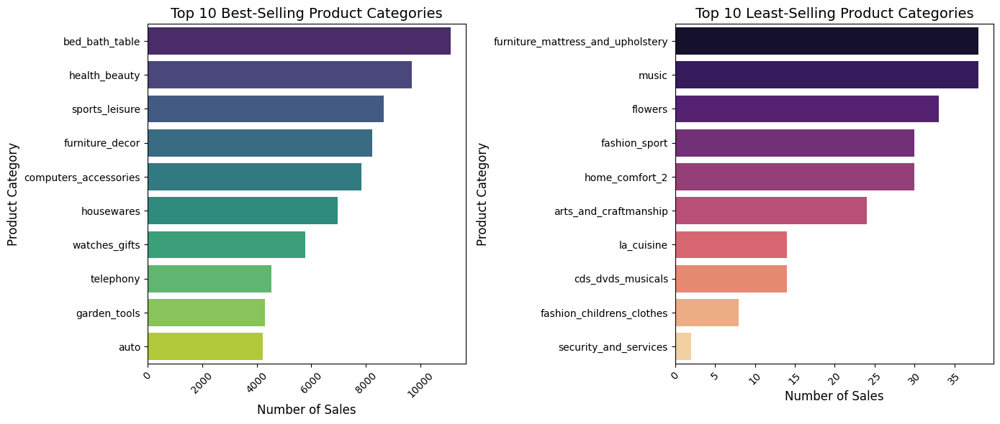

In [35]:
# Set the figure size for both plots
plt.figure(figsize=(14, 6))

# Plot 1: Top 10 Best-Selling Categories
plt.subplot(1, 2, 1)  # 1 row, 2 columns, first plot
sns.barplot(
    x='number_of_sales', 
    y='product_category_name_english', 
    data=category_sales_sorted.head(10),  # Top 10 best-selling
    palette='viridis'
)
plt.title('Top 10 Best-Selling Product Categories', fontsize=14)
plt.xlabel('Number of Sales', fontsize=12)
plt.ylabel('Product Category', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# Plot 2: Top 10 Least-Selling Categories
plt.subplot(1, 2, 2)  # 1 row, 2 columns, second plot
sns.barplot(
    x='number_of_sales', 
    y='product_category_name_english', 
    data=category_sales_sorted.tail(10),  # Top 10 least-selling
    palette='magma'
)
plt.title('Top 10 Least-Selling Product Categories', fontsize=14)
plt.xlabel('Number of Sales', fontsize=12)
plt.ylabel('Product Category', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

#### pie chart

Number of categories combined into 'Other': 51


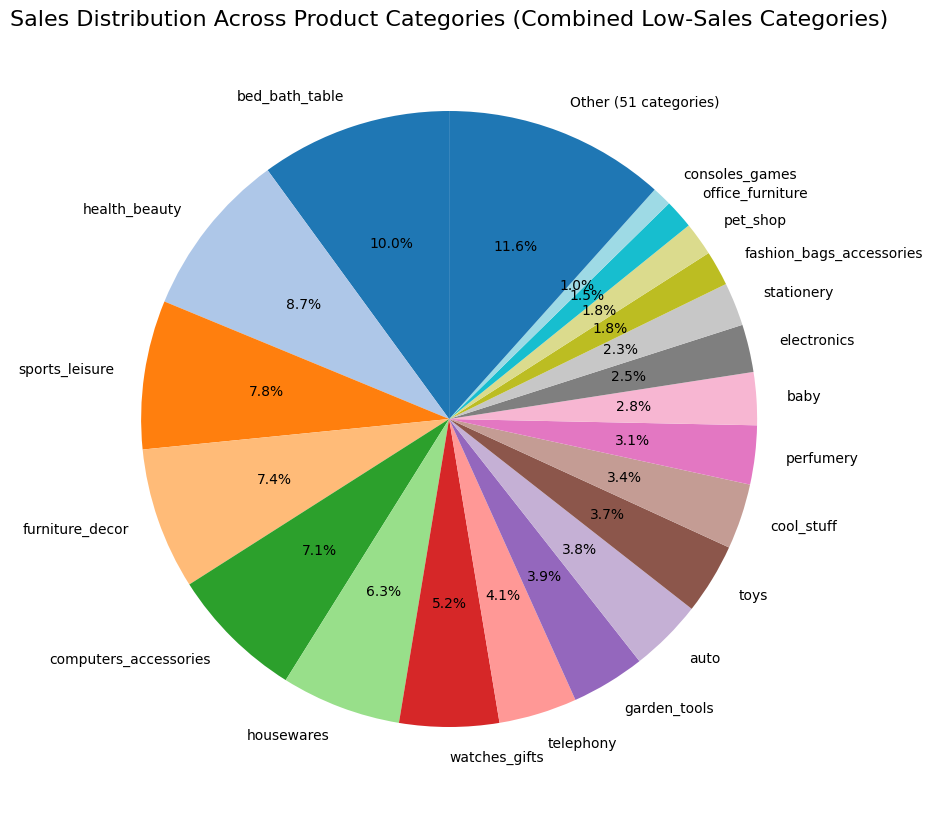

In [36]:
# Step 1: Merge Datasets and Calculate Sales by Category
# Merge order_items_df with products_df to get product_category_name
order_items_with_category = pd.merge(
    order_items_df, 
    products_df[['product_id', 'product_category_name']], 
    on='product_id', 
    how='left'
)

# Merge with product_category_translation_df to get product_category_name_english
order_items_with_category = pd.merge(
    order_items_with_category, 
    product_category_translation_df, 
    on='product_category_name', 
    how='left'
)

# Group by product_category_name_english and count the number of orders
category_sales_count = order_items_with_category.groupby('product_category_name_english')['order_id'].count().reset_index()
category_sales_count.columns = ['product_category_name_english', 'number_of_sales']

# Sort by number_of_sales to get the best-selling and least-selling categories
category_sales_sorted = category_sales_count.sort_values(by='number_of_sales', ascending=False)

# Step 2: Define a Threshold and Combine Low-Sales Categories
# Define a threshold for low sales (e.g., categories with less than 1% of total sales)
threshold = 0.01  # 1% threshold

# Calculate the total number of sales
total_sales = category_sales_sorted['number_of_sales'].sum()

# Identify categories with sales below the threshold
low_sales_categories = category_sales_sorted[category_sales_sorted['number_of_sales'] / total_sales < threshold]

# Combine low-sales categories into an "Other" category
other_category = pd.DataFrame({
    'product_category_name_english': ['Other'],
    'number_of_sales': [low_sales_categories['number_of_sales'].sum()]
})

# Filter out low-sales categories and add the "Other" category
filtered_categories = category_sales_sorted[category_sales_sorted['number_of_sales'] / total_sales >= threshold]
filtered_categories = pd.concat([filtered_categories, other_category], ignore_index=True)

# Step 3: Count the Number of Categories in "Other"
# Count the number of categories in the "Other" slice
num_categories_in_other = len(low_sales_categories)

# Print the result
print(f"Number of categories combined into 'Other': {num_categories_in_other}")

# Update the "Other" label to include the number of categories
filtered_categories.loc[filtered_categories['product_category_name_english'] == 'Other', 'product_category_name_english'] = \
    f"Other ({num_categories_in_other} categories)"

# Step 4: Create the Pie Chart
plt.figure(figsize=(10, 10))
plt.pie(
    filtered_categories['number_of_sales'], 
    labels=filtered_categories['product_category_name_english'], 
    autopct='%1.1f%%',  # Show percentage with 1 decimal place
    startangle=90,  # Rotate the pie chart for better readability
    colors=plt.cm.tab20.colors  # Use a color palette
)
plt.title('Sales Distribution Across Product Categories (Combined Low-Sales Categories)', fontsize=16)
plt.show()

### Pertanyaan 2:

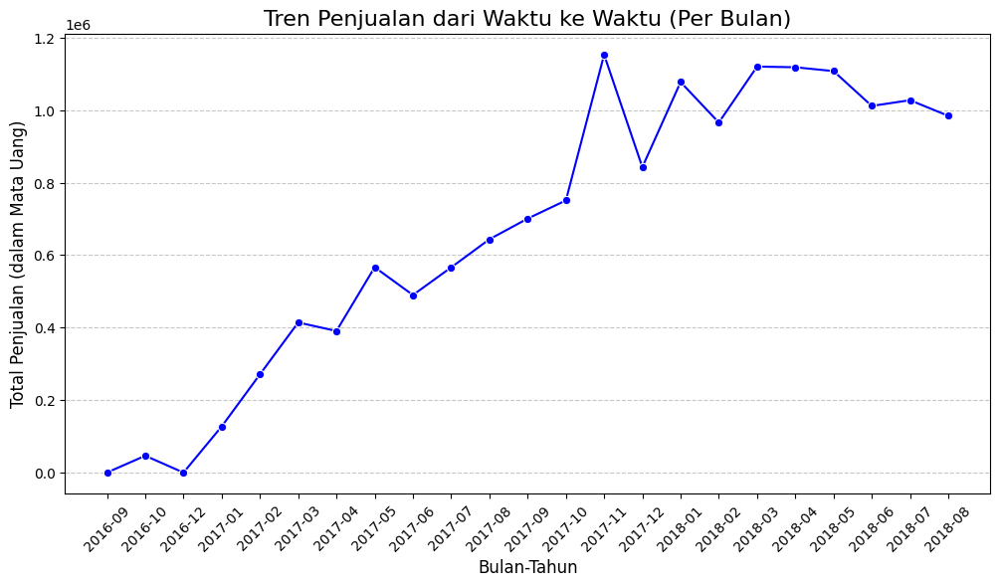

In [37]:
# Set the figure size
plt.figure(figsize=(12, 6))

# Plot the sales trend
sns.lineplot(
    x='year_month', 
    y='total_sales_value', 
    data=monthly_sales, 
    marker='o', 
    color='b'
)

# Add labels and title
plt.title('Tren Penjualan dari Waktu ke Waktu (Per Bulan)', fontsize=16)
plt.xlabel('Bulan-Tahun', fontsize=12)
plt.ylabel('Total Penjualan (dalam Mata Uang)', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.show()

**Insight:**
- xxx
- xxx

## Analisis Lanjutan (Opsional)

### RFM Analysis

Best Customers:
                            customer_id  recency  frequency  monetary  \
16352  2a0bf30f53d53c759be496caad1e1ae2       69          5    312.34   
20843  35aa57b591f1dd750d03ad11047bf18a       90          6    224.13   
25714  42568702f6b7a0d94ad168a4b1dbe0eb       62          5    207.21   
42440  6dc07a25c59429bb3dded5bf3545f23f      126          6    367.54   
42819  6eb400779c4aad2461aa5f0badbcf7ec       76          5    284.82   
45938  768eba0592dcb00cff1bd76eda466c96       83          7    309.80   
56119  90bd3163f91abddea340d03ca4eaf140       71          7    223.54   
81789  d1ea705f2fdd8f98eff86c2691652e60      112         14    529.55   
92791  ee77f26187dacda2a0bb88236aa24bf5      131          5    221.43   
95383  f5498d05cf105bdd3bc601ff77601d7b       76          7    212.60   

      recency_score frequency_score monetary_score rfm_score  
16352             5               5              5       555  
20843             5               5              5    

C:\Users\aimam\AppData\Local\Temp\ipykernel_15060\4268578497.py:81: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


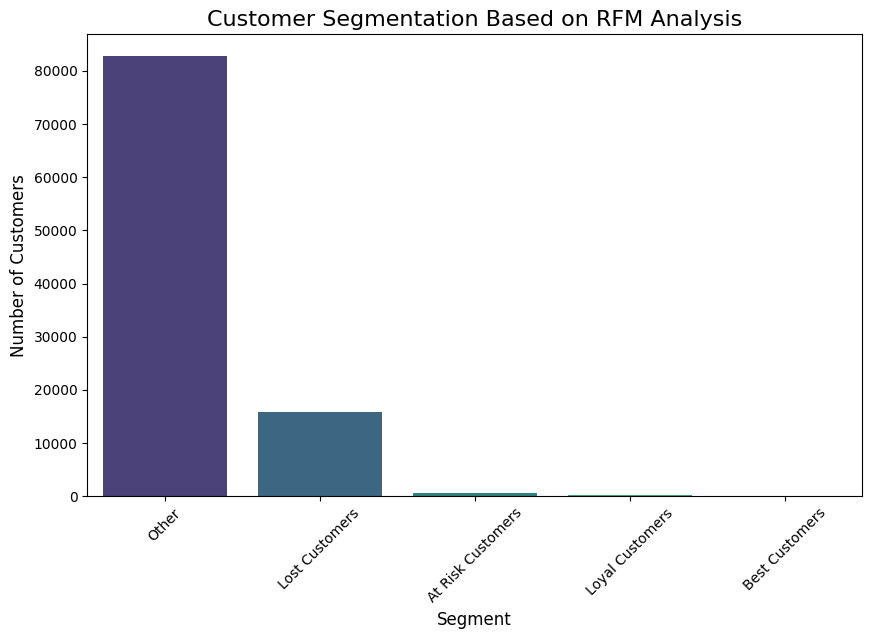

Best Customers Sorted by Monetary Value:
                            customer_id  recency  frequency  monetary  \
81789  d1ea705f2fdd8f98eff86c2691652e60      112         14    529.55   
42440  6dc07a25c59429bb3dded5bf3545f23f      126          6    367.54   
16352  2a0bf30f53d53c759be496caad1e1ae2       69          5    312.34   
45938  768eba0592dcb00cff1bd76eda466c96       83          7    309.80   
42819  6eb400779c4aad2461aa5f0badbcf7ec       76          5    284.82   

      recency_score frequency_score monetary_score rfm_score  
81789             5               5              5       555  
42440             5               5              5       555  
16352             5               5              5       555  
45938             5               5              5       555  
42819             5               5              5       555  


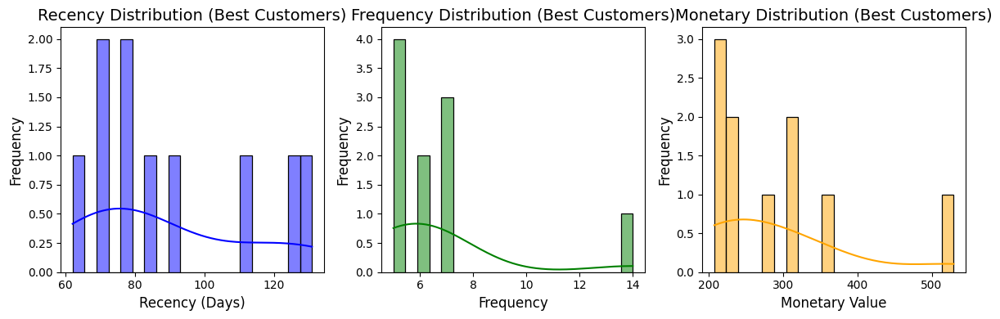

                        customer_id  recency  frequency  monetary  \
0  00012a2ce6f8dcda20d059ce98491703      337          1    114.74   
1  000161a058600d5901f007fab4c27140      458          1     67.41   
2  0001fd6190edaaf884bcaf3d49edf079      596          1    195.42   
3  0002414f95344307404f0ace7a26f1d5      427          1    179.35   
4  000379cdec625522490c315e70c7a9fb      198          1    107.01   

  recency_score frequency_score monetary_score rfm_score  
0             2               2              3       223  
1             1               2              2       122  
2             1               2              4       124  
3             2               2              4       224  
4             4               2              3       423  


In [38]:
# Step 1: Prepare the Data
# Merge orders_df with order_payments_df to get payment_value for each order
customer_orders = pd.merge(
    orders_df[['order_id', 'customer_id', 'order_purchase_timestamp']], 
    order_payments_df[['order_id', 'payment_value']], 
    on='order_id', 
    how='left'
)

# Convert order_purchase_timestamp to datetime
customer_orders['order_purchase_timestamp'] = pd.to_datetime(customer_orders['order_purchase_timestamp'])

# Step 2: Calculate Recency, Frequency, and Monetary Values
# Define the current date (most recent order date)
current_date = customer_orders['order_purchase_timestamp'].max()

# Calculate RFM metrics
rfm_data = customer_orders.groupby('customer_id').agg({
    'order_purchase_timestamp': lambda x: (current_date - x.max()).days,  # Recency
    'order_id': 'count',  # Frequency
    'payment_value': 'sum'  # Monetary
}).reset_index()

# Rename columns
rfm_data.columns = ['customer_id', 'recency', 'frequency', 'monetary']

# Step 3: Assign RFM Scores
# Assign recency scores using pd.qcut()
rfm_data['recency_score'] = pd.qcut(rfm_data['recency'], q=5, labels=[5, 4, 3, 2, 1])

# Define custom bins for frequency
frequency_bins = [0, 1, 2, 3, 5, float('inf')]  # Adjust these bins as needed

# Assign frequency scores using pd.cut()
rfm_data['frequency_score'] = pd.cut(
    rfm_data['frequency'], 
    bins=frequency_bins, 
    labels=[1, 2, 3, 4, 5], 
    right=False  # Include the left edge of the bin
)

# Assign monetary scores using pd.qcut()
rfm_data['monetary_score'] = pd.qcut(rfm_data['monetary'], q=5, labels=[1, 2, 3, 4, 5])

# Combine scores into a single RFM score
rfm_data['rfm_score'] = rfm_data['recency_score'].astype(str) + rfm_data['frequency_score'].astype(str) + rfm_data['monetary_score'].astype(str)

# Step 4: Identify Best Customers
# Identify best customers (RFM score = 555)
best_customers = rfm_data[rfm_data['rfm_score'] == '555']

# Display best customers
print("Best Customers:")
print(best_customers)

# Step 5: Segment Customers
# Define segmentation rules
def rfm_segment(row):
    if row['rfm_score'] == '555':
        return 'Best Customers'
    elif row['frequency_score'] >= 4 and row['monetary_score'] >= 4:
        return 'Loyal Customers'
    elif row['recency_score'] <= 2 and row['frequency_score'] >= 3 and row['monetary_score'] >= 3:
        return 'At Risk Customers'
    elif row['recency_score'] <= 2 and row['frequency_score'] <= 2 and row['monetary_score'] <= 2:
        return 'Lost Customers'
    else:
        return 'Other'

# Apply segmentation
rfm_data['segment'] = rfm_data.apply(rfm_segment, axis=1)

# Count the number of customers in each segment
segment_counts = rfm_data['segment'].value_counts()

# Plot the distribution
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.barplot(
    x=segment_counts.index, 
    y=segment_counts.values, 
    palette='viridis'
)
plt.title('Customer Segmentation Based on RFM Analysis', fontsize=16)
plt.xlabel('Segment', fontsize=12)
plt.ylabel('Number of Customers', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.show()

# Step 7: Analyze Best Customers
#Sort by Monetary Value: Best Customers
best_customers_sorted = best_customers.sort_values(by='monetary', ascending=False)
print("Best Customers Sorted by Monetary Value:")
print(best_customers_sorted.head())

# step 8: Visualize Recency, Frequency, and Monetary Distributions
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
sns.histplot(best_customers['recency'], bins=20, kde=True, color='blue')
plt.title('Recency Distribution (Best Customers)', fontsize=14)
plt.xlabel('Recency (Days)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

plt.subplot(1, 3, 2)
sns.histplot(best_customers['frequency'], bins=20, kde=True, color='green')
plt.title('Frequency Distribution (Best Customers)', fontsize=14)
plt.xlabel('Frequency', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

plt.subplot(1, 3, 3)
sns.histplot(best_customers['monetary'], bins=20, kde=True, color='orange')
plt.title('Monetary Distribution (Best Customers)', fontsize=14)
plt.xlabel('Monetary Value', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

plt.tight_layout()
plt.show()

# step 9: Visualize RFM Scores
print(rfm_data[['customer_id', 'recency', 'frequency', 'monetary', 'recency_score', 'frequency_score', 'monetary_score', 'rfm_score']].head())

### Geospatial Analysis

#### Customer Locations

In [39]:
# Step 1: Merge Customer Data with Geolocation Data
# Merge customers_df with geolocation_df to get latitude and longitude
customer_geolocation = pd.merge(
    customers_df[['customer_id', 'customer_zip_code_prefix']], 
    geolocation_df[['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng']], 
    left_on='customer_zip_code_prefix', 
    right_on='geolocation_zip_code_prefix', 
    how='left'
)

# Drop duplicate columns
customer_geolocation = customer_geolocation.drop(columns=['geolocation_zip_code_prefix'])

# Step 2: Merge Order Data with Customer Geolocation
# Merge orders_df with customer_geolocation to get latitude and longitude for each order
order_geolocation = pd.merge(
    orders_df[['order_id', 'customer_id']], 
    customer_geolocation, 
    on='customer_id', 
    how='left'
)

# Step 3: Drop rows with NaN values in latitude or longitude
customer_geolocation = customer_geolocation.dropna(subset=['geolocation_lat', 'geolocation_lng'])

# Step 4: Sample the Dataset for Visualization
# Sample 10% of the dataset (adjust the fraction as needed)
sampled_customer_geolocation = customer_geolocation.sample(frac=0.1, random_state=42)

# Check the size of the sampled dataset
print(f"Original dataset size: {len(customer_geolocation)}")
print(f"Sampled dataset size: {len(sampled_customer_geolocation)}")

# Step 5: Create a Heatmap of Customer Locations
# Create a base map centered on Brazil
brazil_map = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

# Prepare sampled data for the heatmap (list of [lat, lng] pairs)
heat_data = sampled_customer_geolocation[['geolocation_lat', 'geolocation_lng']].values.tolist()

# Add the heatmap layer to the map
HeatMap(heat_data, radius=10).add_to(brazil_map)

# Display the map
brazil_map

Original dataset size: 10327728
Sampled dataset size: 1032773


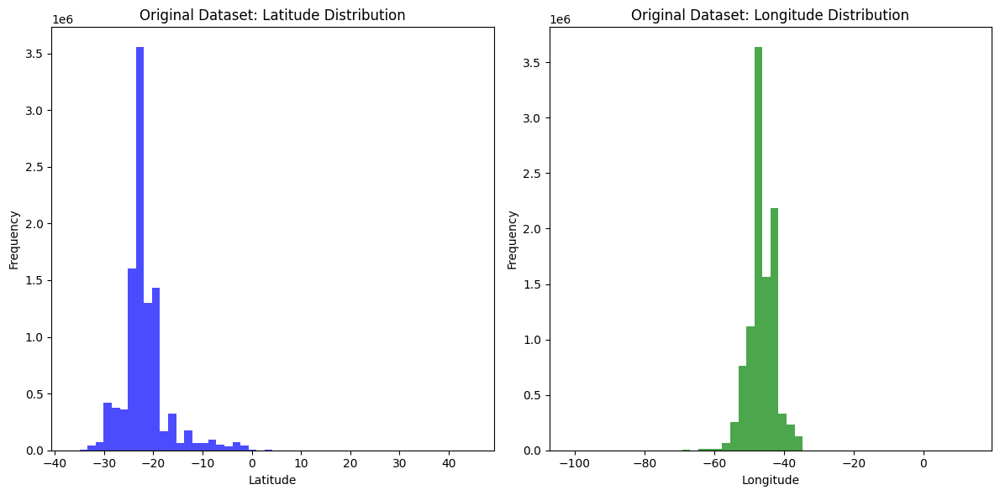

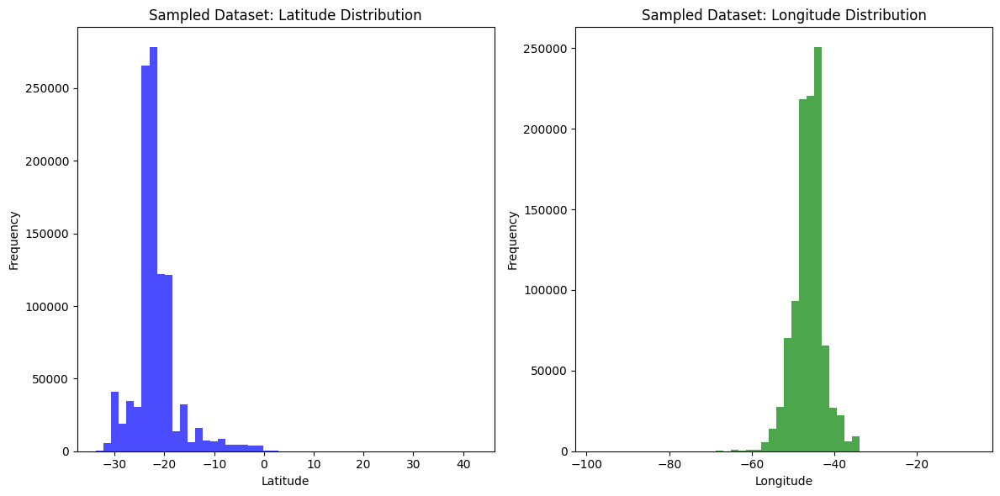

In [40]:
# Step 6: Verify Sampling Results
# Plot the distribution of latitude and longitude in the original dataset
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.hist(customer_geolocation['geolocation_lat'], bins=50, color='blue', alpha=0.7)
plt.title('Original Dataset: Latitude Distribution')
plt.xlabel('Latitude')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(customer_geolocation['geolocation_lng'], bins=50, color='green', alpha=0.7)
plt.title('Original Dataset: Longitude Distribution')
plt.xlabel('Longitude')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# Plot the distribution of latitude and longitude in the sampled dataset
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.hist(sampled_customer_geolocation['geolocation_lat'], bins=50, color='blue', alpha=0.7)
plt.title('Sampled Dataset: Latitude Distribution')
plt.xlabel('Latitude')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(sampled_customer_geolocation['geolocation_lng'], bins=50, color='green', alpha=0.7)
plt.title('Sampled Dataset: Longitude Distribution')
plt.xlabel('Longitude')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

#### Order Density by Region

In [41]:
# step 1: Merge customers_df and orders_df
# Merge customers with orders to get state info
order_geolocation = pd.merge(orders_df, customers_df, on='customer_id', how='left')

# Now, group orders by state
order_density_by_state = order_geolocation.groupby('customer_state')['order_id'].count().reset_index()
order_density_by_state.columns = ['state', 'order_count']

# step 2: Merge with geolocation data
# Group orders by state and count the number of orders
order_density_by_state = order_geolocation.groupby('customer_state')['order_id'].count().reset_index()
order_density_by_state.columns = ['state', 'order_count']

# Merge with geolocation data to get latitude and longitude for each state
state_geolocation = geolocation_df.groupby('geolocation_state').agg({
    'geolocation_lat': 'mean',
    'geolocation_lng': 'mean'
}).reset_index()
state_geolocation.columns = ['state', 'lat', 'lng']

# Merge order density with state geolocation
order_density_map = pd.merge(order_density_by_state, state_geolocation, on='state', how='left')

# step 3: Create a map to visualize order density by state
# Create a map to visualize order density by state
order_density_map_folium = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

# Add order density to the map
for index, row in order_density_map.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['lng']],
        radius=row['order_count'] / 100,  # Scale the radius based on order count
        color='red',  # Marker color
        fill=True,
        fill_color='red',
        fill_opacity=0.6,
        popup=f"State: {row['state']}, Orders: {row['order_count']}"
    ).add_to(order_density_map_folium)

# Display the map
order_density_map_folium

#### Seller Locations

In [42]:
# Merge sellers_df with geolocation_df to get latitude and longitude
seller_geolocation = pd.merge(
    sellers_df[['seller_id', 'seller_zip_code_prefix']], 
    geolocation_df[['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng']], 
    left_on='seller_zip_code_prefix', 
    right_on='geolocation_zip_code_prefix', 
    how='left'
)

# Drop duplicate columns
seller_geolocation = seller_geolocation.drop(columns=['geolocation_zip_code_prefix'])

# Drop rows with missing latitude or longitude
seller_geolocation = seller_geolocation.dropna(subset=['geolocation_lat', 'geolocation_lng'])

# Ensure latitude and longitude are floats
seller_geolocation['geolocation_lat'] = pd.to_numeric(seller_geolocation['geolocation_lat'], errors='coerce')
seller_geolocation['geolocation_lng'] = pd.to_numeric(seller_geolocation['geolocation_lng'], errors='coerce')

# Drop rows where conversion failed
seller_geolocation = seller_geolocation.dropna(subset=['geolocation_lat', 'geolocation_lng'])

# Filter out invalid coordinates
valid_coords = (
    (seller_geolocation['geolocation_lat'].between(-90, 90)) &
    (seller_geolocation['geolocation_lng'].between(-180, 180))
)
seller_geolocation = seller_geolocation[valid_coords]

# Sample 10% of the seller dataset
sampled_seller_geolocation = seller_geolocation.sample(frac=0.1, random_state=42)

# Check the size of the sampled dataset
print(f"Original seller dataset size: {len(seller_geolocation)}")
print(f"Sampled seller dataset size: {len(sampled_seller_geolocation)}")

# Create heatmap of seller locations
seller_heatmap = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

# Prepare sampled data for the heatmap (list of [lat, lng] pairs)
seller_heat_data = sampled_seller_geolocation[['geolocation_lat', 'geolocation_lng']].dropna().values.tolist()

# Double-check for any invalid entries
valid_heat_data = [[lat, lng] for lat, lng in seller_heat_data if isinstance(lat, (int, float)) and isinstance(lng, (int, float))]

# Add the heatmap layer to the map
HeatMap(
    valid_heat_data, 
    radius=10, 
    gradient={'0.2': 'blue', '0.4': 'lime', '0.6': 'orange', '1': 'red'}
).add_to(seller_heatmap)

# Display the heatmap
seller_heatmap


Original seller dataset size: 311789
Sampled seller dataset size: 31179


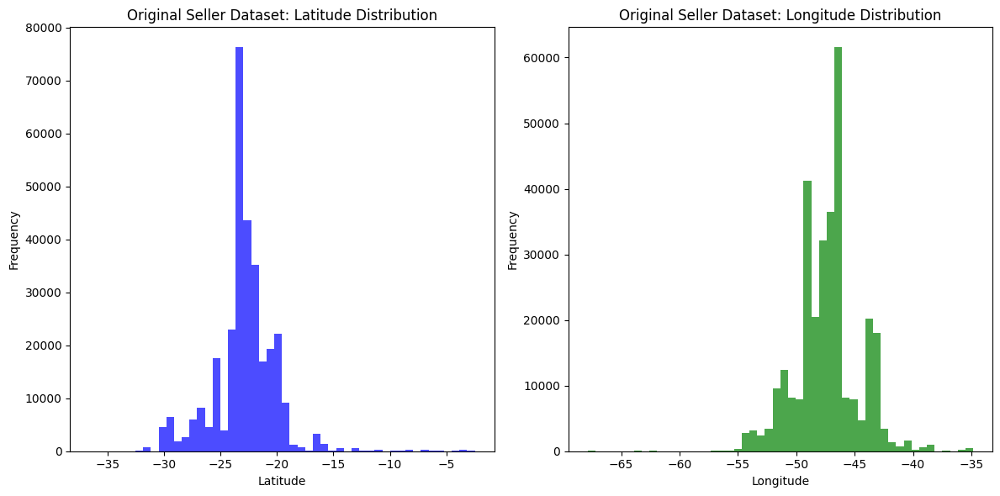

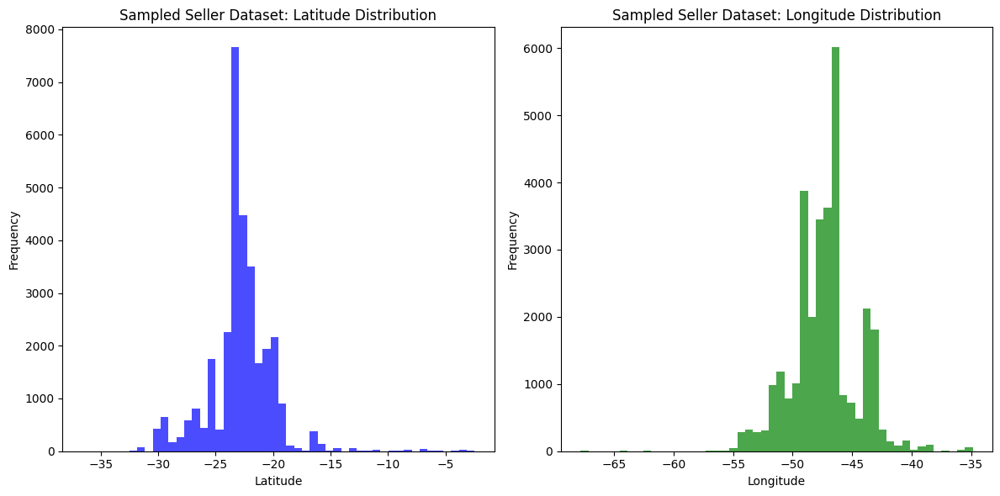

In [43]:
# Verify seller sampling by comparing distributions (similar to customer verification)
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.hist(seller_geolocation['geolocation_lat'], bins=50, color='blue', alpha=0.7)
plt.title('Original Seller Dataset: Latitude Distribution')
plt.xlabel('Latitude')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(seller_geolocation['geolocation_lng'], bins=50, color='green', alpha=0.7)
plt.title('Original Seller Dataset: Longitude Distribution')
plt.xlabel('Longitude')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# Plot the distribution of latitude and longitude in the sampled dataset
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.hist(sampled_seller_geolocation['geolocation_lat'], bins=50, color='blue', alpha=0.7)
plt.title('Sampled Seller Dataset: Latitude Distribution')
plt.xlabel('Latitude')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(sampled_seller_geolocation['geolocation_lng'], bins=50, color='green', alpha=0.7)
plt.title('Sampled Seller Dataset: Longitude Distribution')
plt.xlabel('Longitude')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

#### Analyze Customer-Seller Distance

In [44]:
# Sample data with consistent sample fraction and random state
sample_fraction = 0.1
random_state = 42  # Using a standard random seed

# Sample only the necessary columns from each dataframe
customers_sample = customers_df[['customer_id', 'customer_zip_code_prefix']].sample(
    frac=sample_fraction, random_state=random_state)

geolocation_sample = geolocation_df[['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng']].sample(
    frac=sample_fraction, random_state=random_state)

orders_sample = orders_df[['order_id', 'customer_id']].sample(
    frac=sample_fraction, random_state=random_state)

order_items_sample = order_items_df[['order_id', 'seller_id']].sample(
    frac=sample_fraction, random_state=random_state)

# Get seller geolocation data
seller_geolocation_sample = seller_geolocation.sample(
    frac=sample_fraction, random_state=random_state)
seller_geolocation_sample = seller_geolocation_sample.rename(columns={
    'geolocation_lat': 'geolocation_lat_seller',
    'geolocation_lng': 'geolocation_lng_seller'
})

# Create customer geolocation lookup in one step
customer_geolocation = pd.merge(
    customers_sample, 
    geolocation_sample,
    left_on='customer_zip_code_prefix',
    right_on='geolocation_zip_code_prefix',
    how='inner'  # Changed to inner to avoid NaN values later
).drop(columns=['geolocation_zip_code_prefix'])

# Link orders to customer locations in one operation
order_geolocation = pd.merge(
    orders_sample,
    customer_geolocation,
    on='customer_id',
    how='inner'  # Changed to inner to avoid NaN values
)

# Link orders to sellers
order_seller = order_items_sample.drop_duplicates()

# Create final merged dataset with all necessary coordinates
customer_seller_distance = pd.merge(
    pd.merge(
        order_geolocation[['order_id', 'geolocation_lat', 'geolocation_lng']].rename(columns={
            'geolocation_lat': 'geolocation_lat_customer',
            'geolocation_lng': 'geolocation_lng_customer'
        }),
        order_seller,
        on='order_id',
        how='inner'
    ),
    seller_geolocation_sample,
    on='seller_id',
    how='inner'
)

# Calculate distances
customer_seller_distance['distance_km'] = customer_seller_distance.apply(
    lambda row: geodesic(
        (row['geolocation_lat_customer'], row['geolocation_lng_customer']),
        (row['geolocation_lat_seller'], row['geolocation_lng_seller'])
    ).km,
    axis=1
)

# Display the average distance
print(f"Average Distance Between Customer and Seller: {customer_seller_distance['distance_km'].mean():.2f} km")

Average Distance Between Customer and Seller: 460.28 km


### Clustering

## Conclusion

- Conclution pertanyaan 1
- Conclution pertanyaan 2